In [715]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import glob
import os
from tqdm import tqdm

%matplotlib inline

In [716]:
X =[]
Z = []
IMG_SIZE = 150
FLOWER_SUNFLOWER_DIR = '/kaggle/input/flowers-recognition/flowers/sunflower'
def assign_label(img, flower_type):
    return flower_type

In [717]:
def make_train_data(flower_type, DIR):
    for img in tqdm(os.listdir(DIR)):
        label = assign_label(img, flower_type)
        path = os.path.join(DIR, img)
        img = cv2.imread(path, cv2.IMREAD_COLOR)
        img = cv2.resize(img, (IMG_SIZE, IMG_SIZE))
        
        X.append(np.array(img))
        Z.append(str(label))

In [718]:
make_train_data('Sunflower', FLOWER_SUNFLOWER_DIR)
print(len(X))

100%|██████████| 733/733 [00:03<00:00, 221.47it/s]

733


### RGB Color Space

In [719]:
fix_img = cv2.cvtColor(X[0], cv2.COLOR_BGR2RGB)

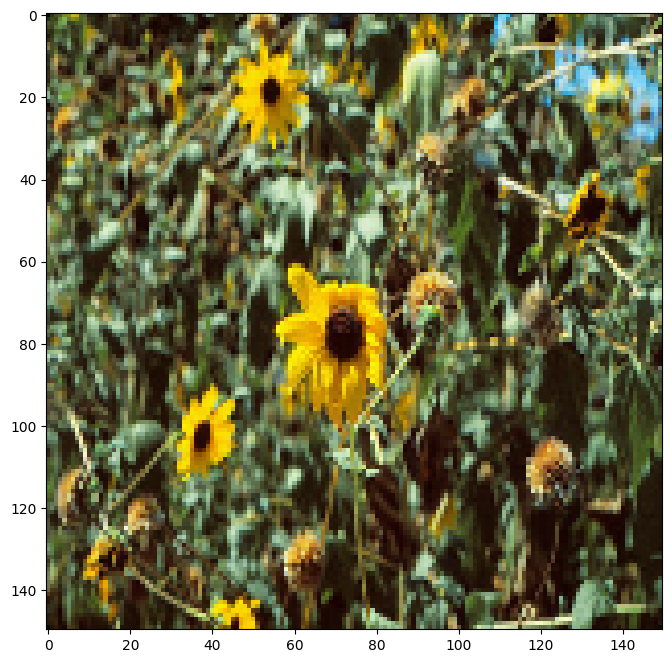

In [720]:
plt.figure(figsize = (12, 8))
plt.imshow(fix_img)

In [721]:
new_img_1 = fix_img.copy()

In [722]:
print(fix_img.shape)
print(new_img_1.shape)

(150, 150, 3)
(150, 150, 3)


In [723]:
new_img_1[:, :, 0] = 0 # R 채널을 0으로 
new_img_1[:, :, 1] = 0 # G 채널을 0으로

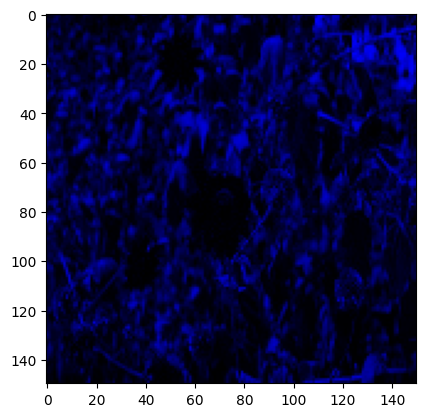

In [724]:
plt.imshow(new_img_1)

In [725]:
new_img_2 = fix_img.copy()
new_img_3 = fix_img.copy()

In [726]:
# R 채널
new_img_2[:, :, 1] = 0
new_img_2[:, :, 2] = 0
# G 채널
new_img_3[:, :, 0] = 0
new_img_3[:, :, 2] = 0

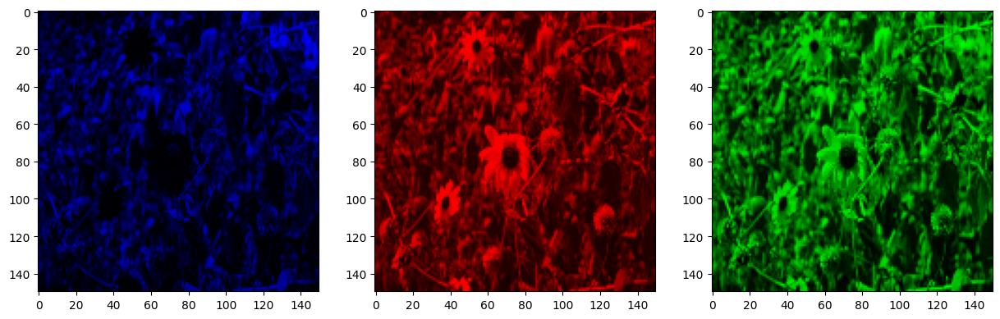

In [727]:
f, axes = plt.subplots(1,3, figsize = (15,15))
list = [new_img_1,new_img_2,new_img_3]
i = 0
for ax in axes:
    ax.imshow(list[i])
    i+=1

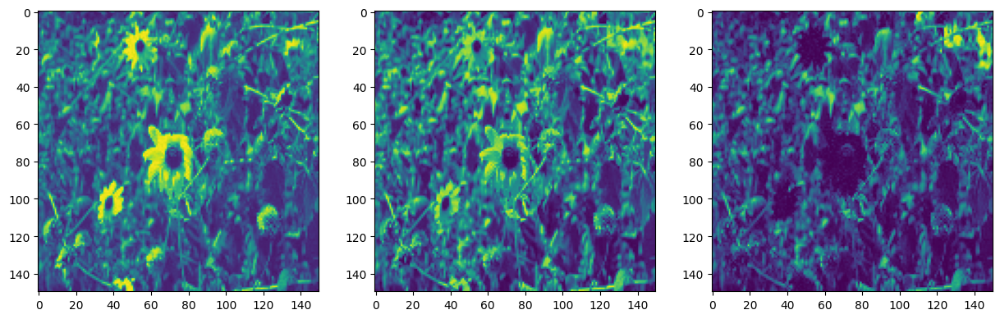

In [728]:
f, axes = plt.subplots(1,3, figsize = (15,15))
list = [fix_img[:,:,0],fix_img[:,:,1],fix_img[:,:,2]]
i = 0
for ax in axes:
    ax.imshow(list[i])
    i+=1

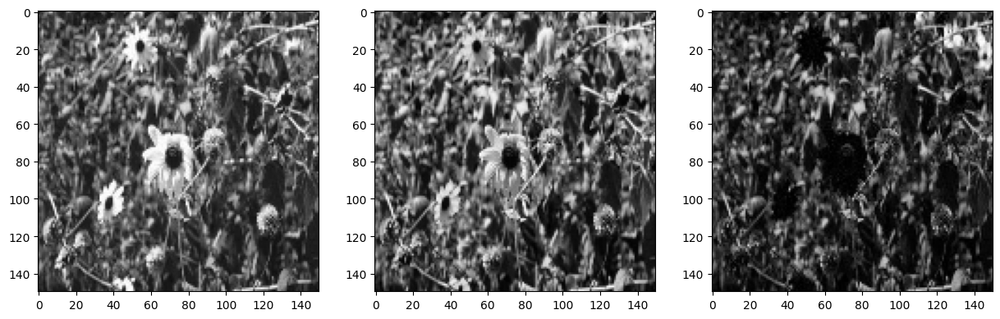

In [729]:
f, axes = plt.subplots(1,3, figsize = (15,15))
list = [fix_img[:,:,0],fix_img[:,:,1],fix_img[:,:,2]]
i = 0
for ax in axes:
    ax.imshow(list[i],cmap = 'gray')
    i+=1

### RGB to HSL

HSL은 Hue(색상), Saturation(채도), and Lightness(밝기)를 의미.

In [730]:
hsl_img = cv2.cvtColor(X[0], cv2.COLOR_BGR2HLS)

In [731]:
hsl_img.shape

(150, 150, 3)

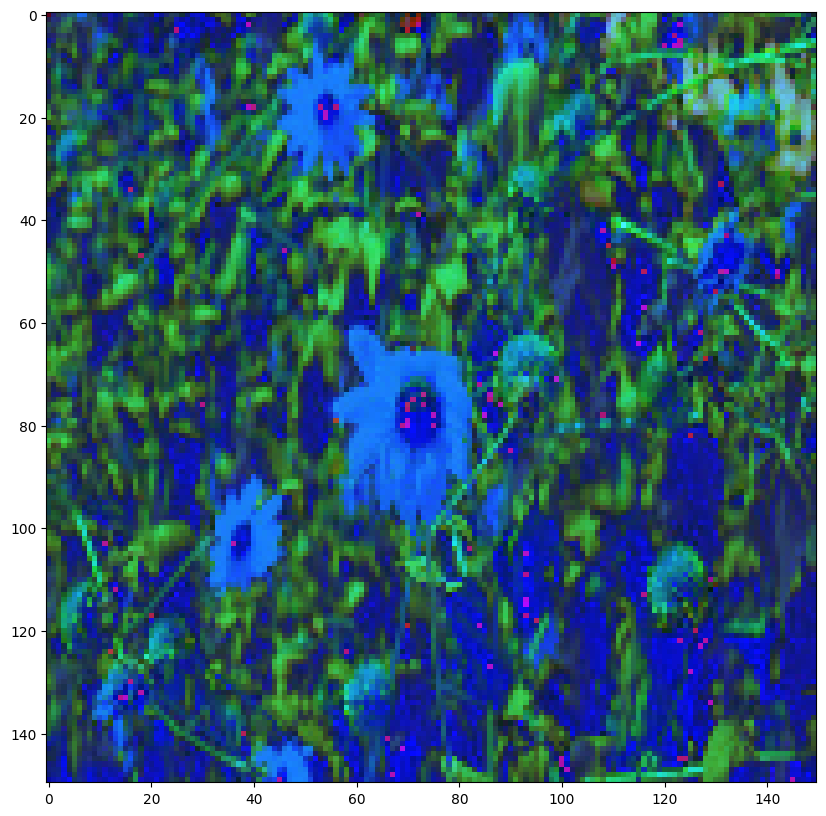

In [732]:
plt.figure(figsize=(12, 10))
plt.imshow(hsl_img)

In [733]:
hsl_img_1 = hsl_img.copy()
hsl_img_2 = hsl_img.copy()
hsl_img_3 = hsl_img.copy()

In [734]:
# HUE -> 0
hsl_img_1[:, :, 1] = 0
hsl_img_1[:, :, 2] = 0
# SATURATION -> 0
hsl_img_2[:, : ,0] = 0
hsl_img_2[:, :, 2] = 0
# LIGHTNESS -> 0
hsl_img_3[:, :, 0] = 0
hsl_img_3[:, :, 1] = 0

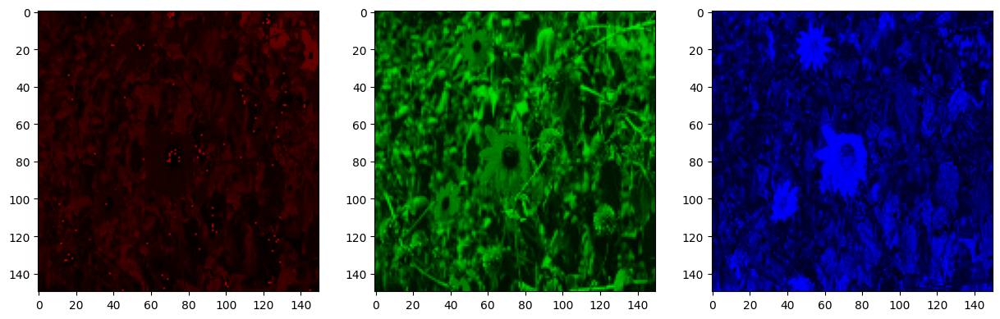

In [735]:
f, axes = plt.subplots(1,3, figsize = (15,15))
list = [hsl_img_1,hsl_img_2,hsl_img_3]
i = 0
for ax in axes:
    ax.imshow(list[i])
    i+=1

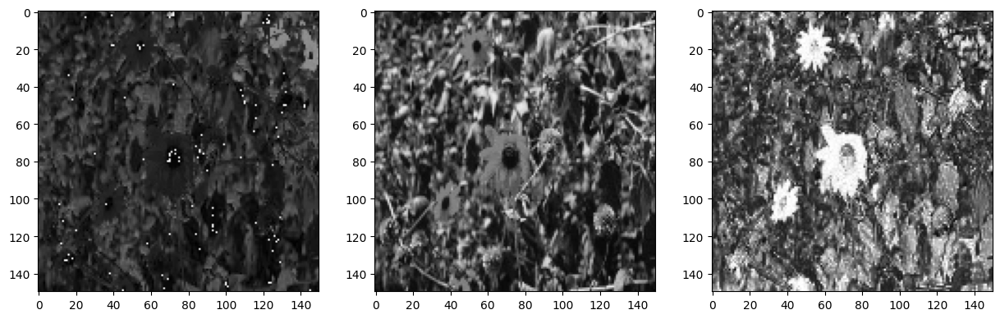

In [736]:
f, axes = plt.subplots(1,3, figsize = (15,15))
list = [hsl_img[:,:,0],hsl_img[:,:,1],hsl_img[:,:,2]]
i = 0
for ax in axes:
    ax.imshow(list[i],cmap = "gray")
    i+=1

### RGB to HSV

HSV는 Hue(색조), Saturation(채도), Value(명도)로 이루어짐.

In [737]:
hsv_img = cv2.cvtColor(X[0], cv2.COLOR_BGR2HSV)

In [738]:
hsv_img.shape

(150, 150, 3)

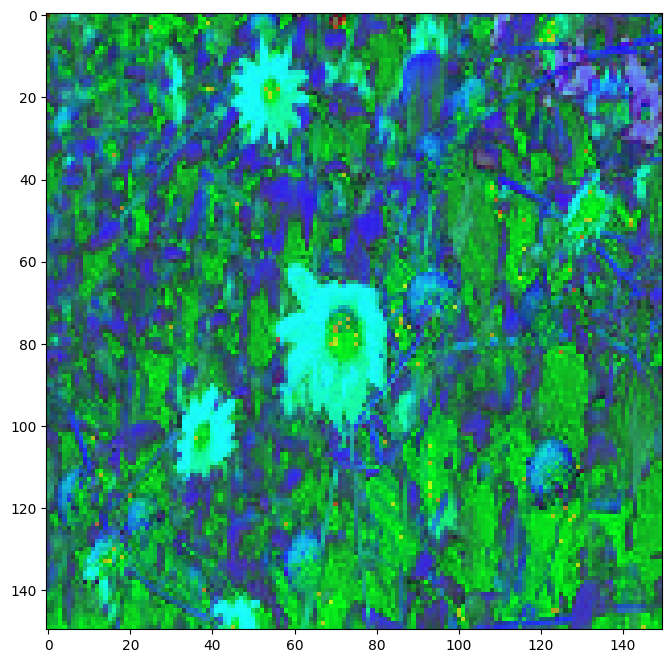

In [739]:
plt.figure(figsize = (10, 8))
plt.imshow(hsv_img)

In [740]:
hsv_img_1 = hsv_img.copy()
hsv_img_2 = hsv_img.copy()
hsv_img_3 = hsv_img.copy()

In [741]:
# HUE -> 0
hsv_img_1[:, :, 1] = 0
hsv_img_1[:, :, 2] = 0
# SATURATION -> 0
hsv_img_2[:, : ,0] = 0
hsv_img_2[:, :, 2] = 0
# VALUE -> 0
hsv_img_3[:, :, 0] = 0
hsv_img_3[:, :, 1] = 0

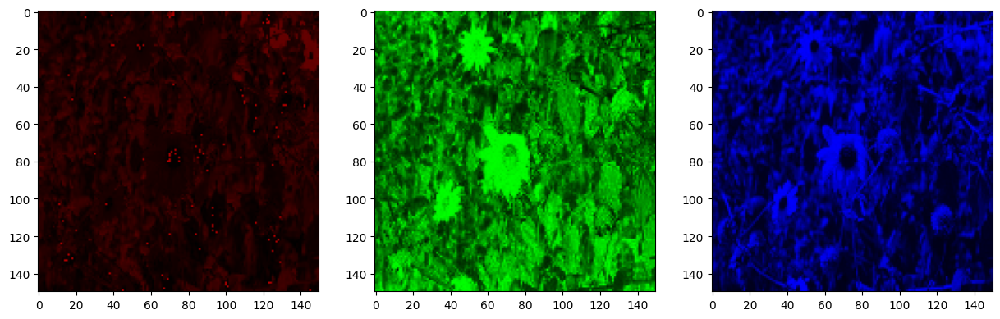

In [742]:
f, axes = plt.subplots(1,3, figsize = (15,15))
list = [hsv_img_1,hsv_img_2,hsv_img_3]
i = 0
for ax in axes:
    ax.imshow(list[i])
    i+=1

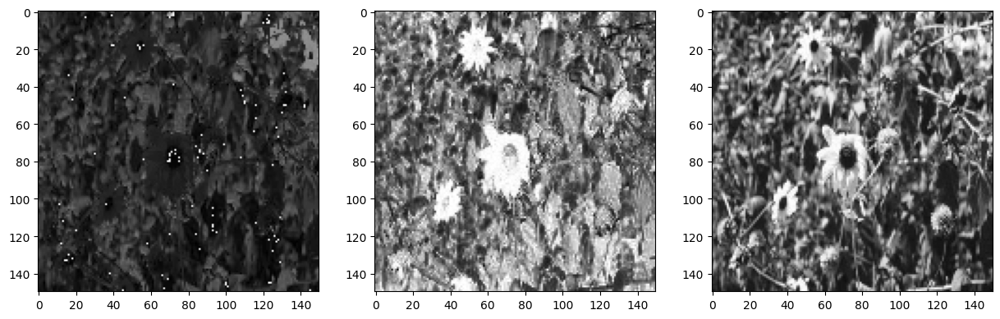

In [743]:
f, axes = plt.subplots(1,3, figsize = (15,15))
list = [hsv_img[:,:,0],hsv_img[:,:,1],hsv_img[:,:,2]]
i = 0
for ax in axes:
    ax.imshow(list[i],cmap = "gray")
    i+=1

### Basic Geometric Transformations:
- Image Translation
- Image Resizing
- Image Rotating
- Image Cropping

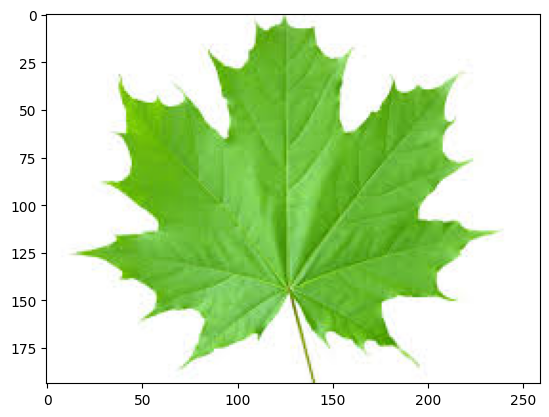

In [744]:
pic = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/leaf.jfif')
pic = cv2.cvtColor(pic,cv2.COLOR_BGR2RGB)
plt.imshow(pic)

In [745]:
type(pic)

numpy.ndarray

In [746]:
matrix = np.float32([[1, 0, 20], [0, 1, 30]])

In [747]:
rows, cols, chn = pic.shape
print('height: {}'.format(rows))
print('width: {}'.format(cols))
print('pic shape: {}'.format(pic.shape))

height: 194
width: 259
pic shape: (194, 259, 3)


In [748]:
translated_pic = cv2.warpAffine(pic, matrix, (cols, rows))

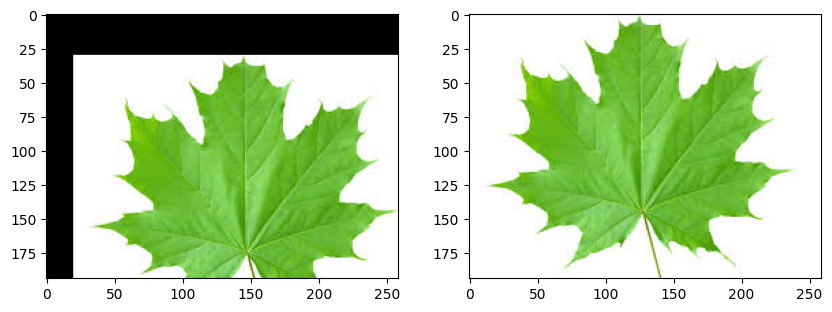

In [749]:
plt.figure(figsize = (10, 8))
plt.subplot(121)
plt.imshow(translated_pic)

plt.subplot(122)
plt.imshow(pic)
plt.show()

In [750]:
translated_pic.shape

(194, 259, 3)

### Resizing

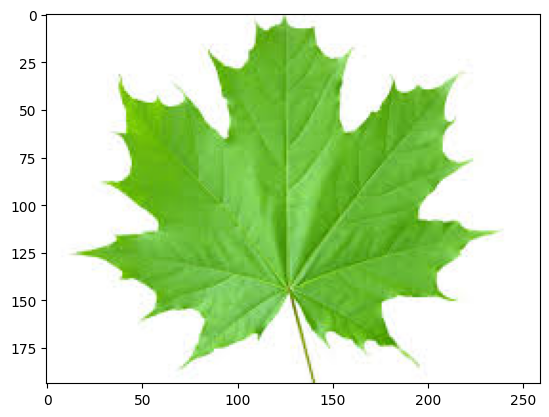

In [751]:
pic = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/leaf.jfif')
pic = cv2.cvtColor(pic,cv2.COLOR_BGR2RGB)
plt.imshow(pic)


In [752]:
pic.shape

(194, 259, 3)

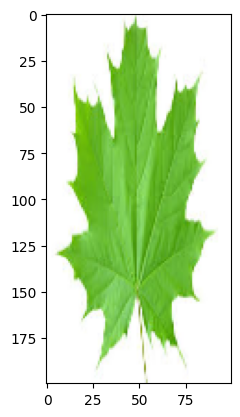

In [753]:
resized_pic = cv2.resize(pic, (100, 200))
plt.imshow(resized_pic)

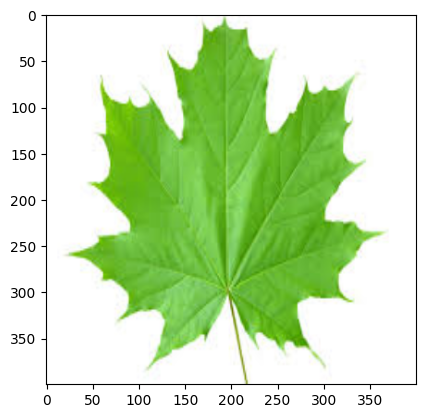

In [754]:
resized_pic = cv2.resize(pic, (400, 400))
plt.imshow(resized_pic)

Fraction(분수)을 사용 -> 이미지 크기를 비율로 조정 가능

In [755]:
width_ratio = 0.5
height_ratio = 0.5 
resized_pic2 = cv2.resize(pic, (0, 0), pic, width_ratio, height_ratio)

shape: (97, 130, 3)


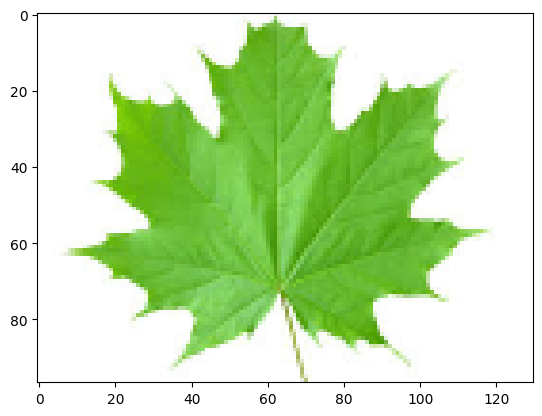

In [756]:
plt.imshow(resized_pic2)
print('shape: {}'.format(resized_pic2.shape))

### Image Rotation

In [757]:
rotate = cv2.flip(pic, 0)

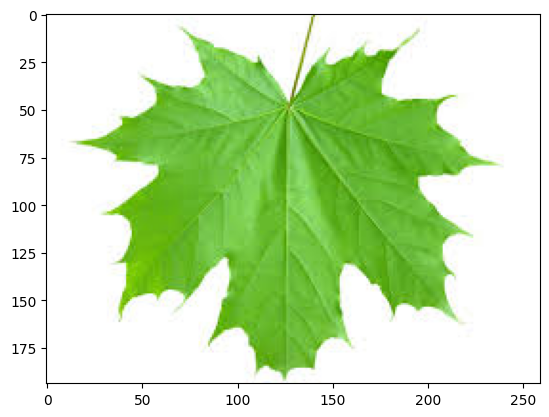

In [758]:
plt.imshow(rotate)

### Image Croping

In [759]:
pic1 = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/gorilla.jpg')
pic1 = cv2.cvtColor(pic1,cv2.COLOR_BGR2RGB)

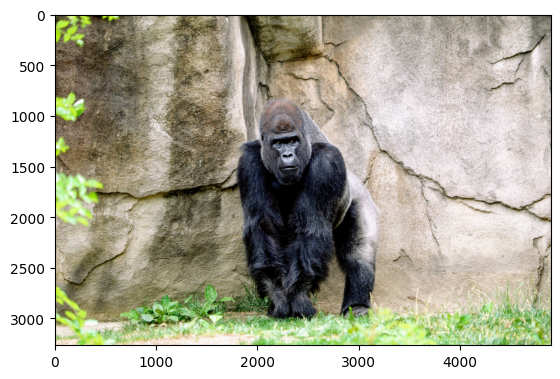

In [760]:
plt.imshow(pic1)

In [761]:
pic1.shape

(3265, 4898, 3)

In [762]:
crop = pic1[800:3000, 1800:3200]

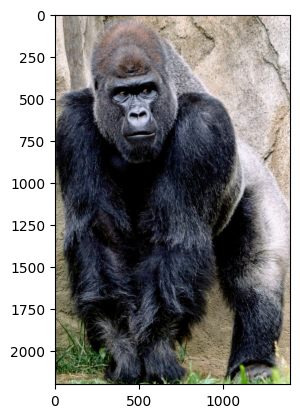

In [763]:
plt.imshow(crop)

## Thresholding

Thresholding은 computer vision에서 여러분야에 적용할 수 있음
1. Segmentation
2. Mask creation
3. Edge Detection
4. Line Detection etc.

thresholded image를 만드는 방법은 image를 0 ~ 255 사이의 값을 갖도록 gray scale로 만든 후 픽셀 값이 원하는 값(임계값)보다 크면 픽셀 값을 1로 바꾸고 원하는 값보다 작은 픽셀을 0으로 바꿈.

`cv2.threshold()`라는 함수를 사용
1. Binary
2. Inverted Binary
3. Truncated
4. To Zero
5. To Zero Inverted
6. Otsu’s Binarization


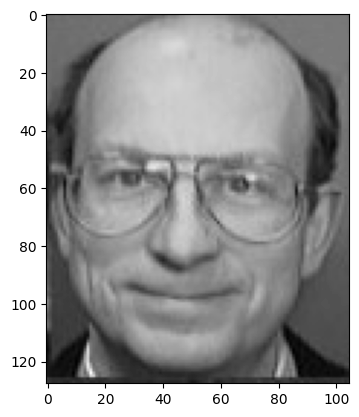

In [764]:
img = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/SharedScreenshot1.jpg',0)
plt.imshow(img,cmap = 'gray')

In [765]:
img.max()/2

122.5

1번째 매개변수는 gray image 

2번째 매개변수는 임계값

3번째 매개변수는 max pixel 값

마지막 매개변수는 thresholding 수행 방법

cv2.THRESH_BINARY: threshold보다 크면 value이고 아니면 0으로 

cv2.THRESH_BINARY_INV: threshold보다 크면 0이고 아니면 value로 

cv2.THRESH_TRUNC: threshold보다 크면 value로 지정하고 작으면 기존의 값 그대로 사용

cv2.THRESH_TOZERO: treshold_value보다 크면 픽셀 값 그대로 작으면 0으로 할당 

cv2.THRESH_TOZERO_INV: threshold_value보다 크면 0으로 작으면 그대로 할당 

In [766]:
ret3, thresh3 = cv2.threshold(img, 123, 255, cv2.THRESH_TRUNC)

In [767]:
ret, thresh1 = cv2.threshold(img,123,255,cv2.THRESH_BINARY)

In [768]:
ret, thresh2 = cv2.threshold(img,123,255,cv2.THRESH_TRIANGLE)

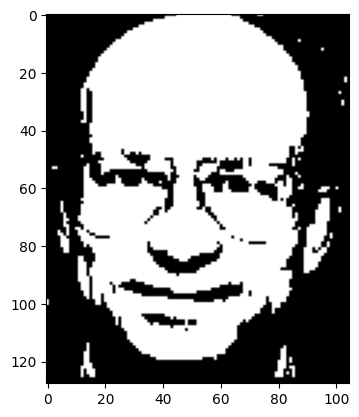

In [769]:
plt.imshow(thresh1, cmap = 'gray')

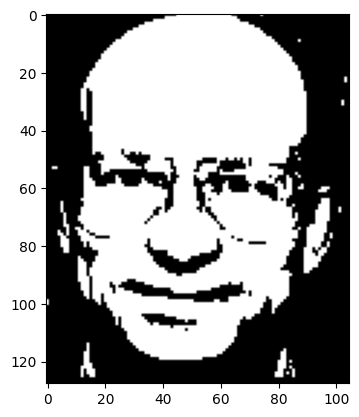

In [770]:
plt.imshow(thresh2,cmap = 'gray')

In [771]:
diff = thresh1 - thresh2

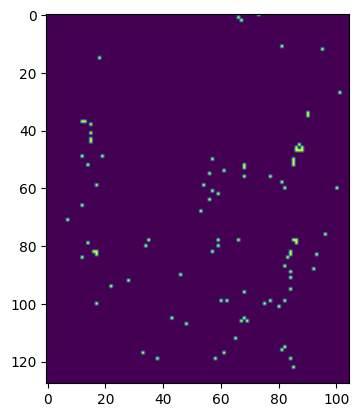

In [772]:
plt.imshow(diff)

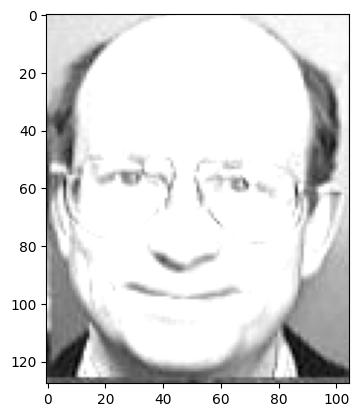

In [773]:
plt.imshow(thresh3,cmap = 'gray')

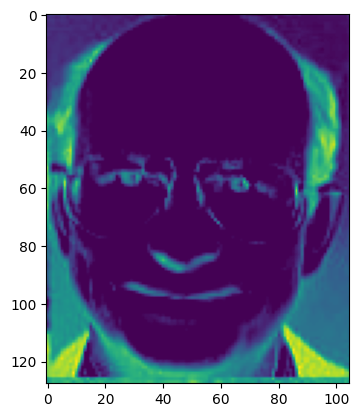

In [774]:
diff1 = thresh1 - thresh3
plt.imshow(diff1)

In [775]:
sum1 = thresh1 + thresh3

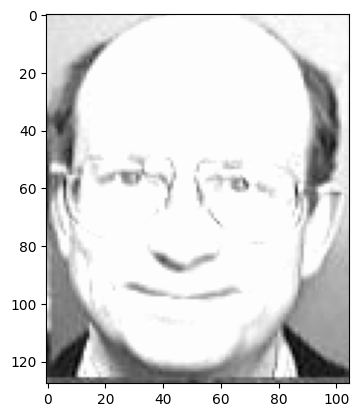

In [776]:
plt.imshow(sum1, cmap = 'gray')

1번째 매개변수는 gray image 

2번째 매개변수는 max pixel 값

3번째 매개변수는 Type for calculating mean

4번째 매개변수는 스레쉬홀딩 type

5번째 매개변수는 block size 

마지막 매개변수는 c 상수

In [777]:
th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,11,8)

In [778]:
th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,11,8)

In [779]:
th = th3 - th2
th.shape

(128, 105)

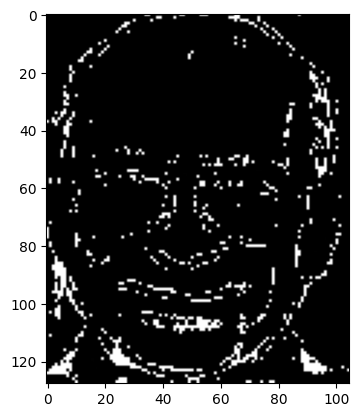

In [780]:
plt.imshow(th,cmap = 'gray')

## Bluring and Smoothing

Feature를 찾거나 Noise를 제거하기 위해서 Bluring과 Smoothing이 사용된다. 

OpenCV에서는 Bluring과 Smooting을 사용할 수 있는 방법이 많다.

1. Gaussion Blurring
2. Median Bluring
3. Bilateral Blurring
4. Gamma Currection
5. Using Builtin Kernels(cv2.blur())
6.Using user defined Kernels(cv2.filter2D()) etc.


In [781]:
def load_img():
    img = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/blue_brick.jpg')
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    return img

In [782]:
def disp_img(img,cmap = None):
    fig = plt.figure(figsize = (8,8))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap)

In [783]:
img1 = load_img()

In [784]:
img1.shape

(194, 259, 3)

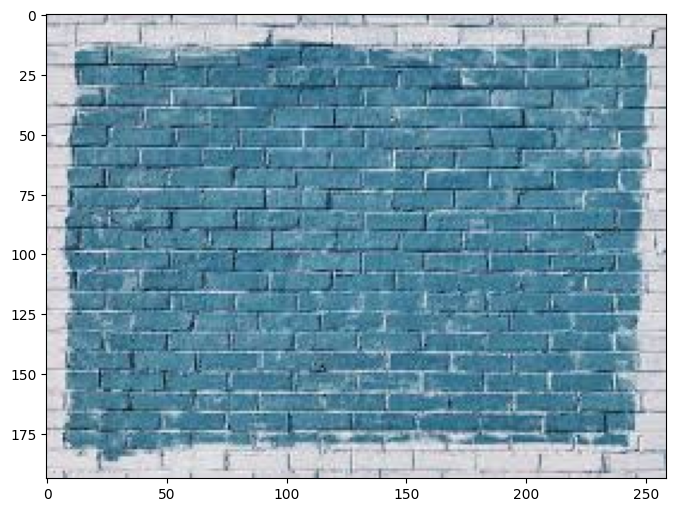

In [785]:
disp_img(img1)

In [786]:
img2 = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img2,text = 'Bricks',org = (10,125),fontFace = font,fontScale = 2,color = (255,0,0),thickness = 1)

array([[[175, 175, 183],
        [200, 200, 208],
        [204, 204, 212],
        ...,
        [196, 197, 201],
        [196, 197, 201],
        [196, 197, 201]],

       [[180, 180, 188],
        [207, 207, 215],
        [207, 207, 215],
        ...,
        [204, 205, 209],
        [204, 205, 209],
        [204, 205, 209]],

       [[186, 186, 194],
        [211, 211, 219],
        [210, 210, 218],
        ...,
        [202, 203, 207],
        [202, 203, 207],
        [202, 203, 207]],

       ...,

       [[222, 220, 223],
        [214, 212, 215],
        [219, 217, 220],
        ...,
        [214, 214, 222],
        [222, 227, 233],
        [215, 218, 225]],

       [[218, 214, 215],
        [217, 215, 218],
        [215, 213, 216],
        ...,
        [208, 209, 214],
        [206, 209, 214],
        [207, 208, 213]],

       [[218, 214, 215],
        [219, 215, 216],
        [215, 213, 218],
        ...,
        [208, 209, 214],
        [208, 209, 214],
        [207, 208, 213]]

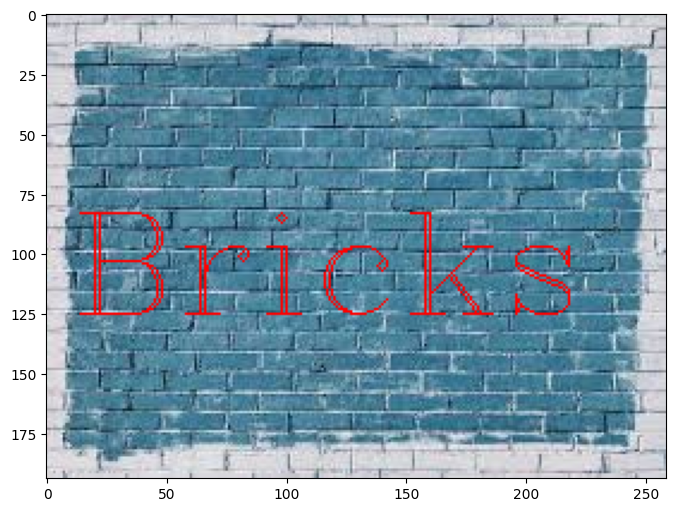

In [787]:
disp_img(img2)

### cv2.filter2D():

커널 만들기

In [788]:
kernel = np.ones(shape=(3,3),dtype = np.float32)/6.07

In [789]:
1/25

0.04

필터 유형:

필터에는 1.LPF(저역 통과 필터)와 2.HPF(고역 통과 필터)가 있음. LPF는 노이즈, 가장자리와 같은 고주파 요소를 제거하여 이미지를 흐리게 하는 데 도움을 줌.

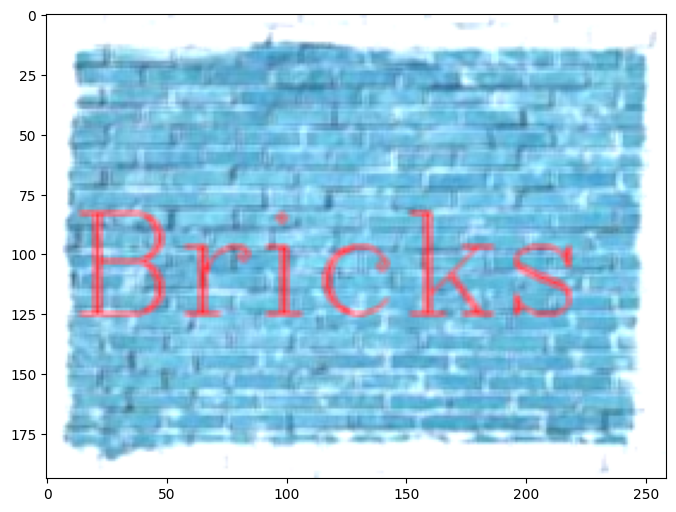

In [790]:
dst = cv2.filter2D(img2, -1, kernel)
disp_img(dst)

### cv2.blur():
필터 아래에 속하는 이미지의 모든 픽셀의 평균을 취하여 해당 값을 중심 픽셀로 바꾸고 계속해서 슬라이딩함으로써 계속 수행. 이 필터는 블러링을 위해 이미지의 가장자리를 제거

In [791]:
img2 = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img2,text = 'Bricks',org = (10,125),fontFace = font,fontScale = 2,color = (255,0,0),thickness = 1)
print('reset')

reset


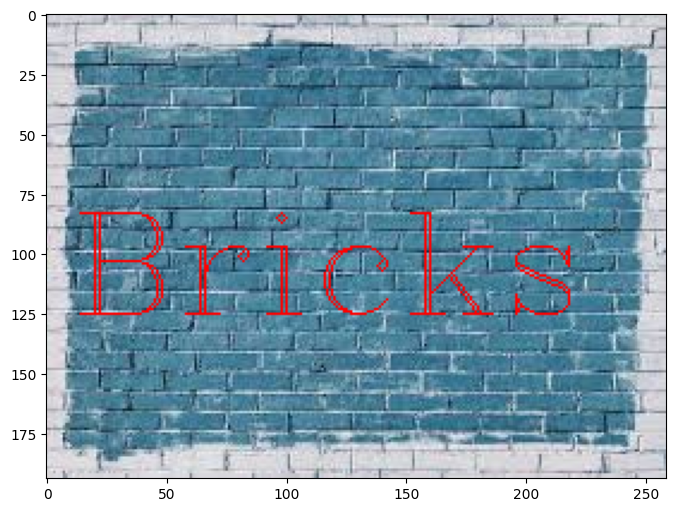

In [792]:
disp_img(img2)

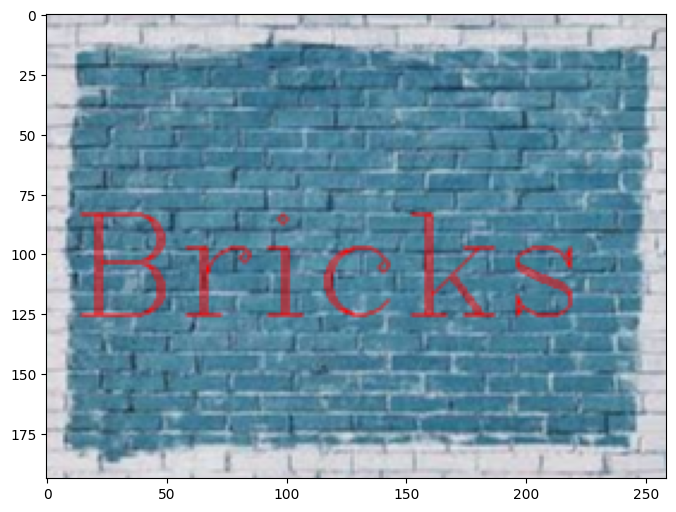

In [793]:
blur = cv2.blur(img2,ksize = (2,2))
disp_img(blur)

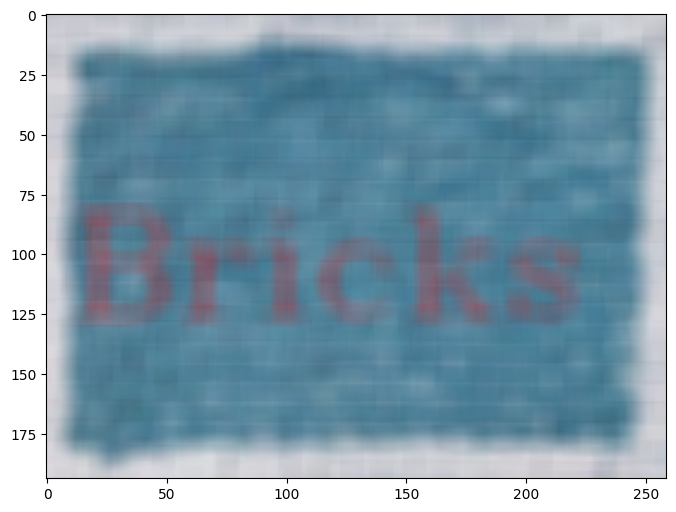

In [794]:
blur = cv2.blur(img2,ksize = (10,10))
disp_img(blur)

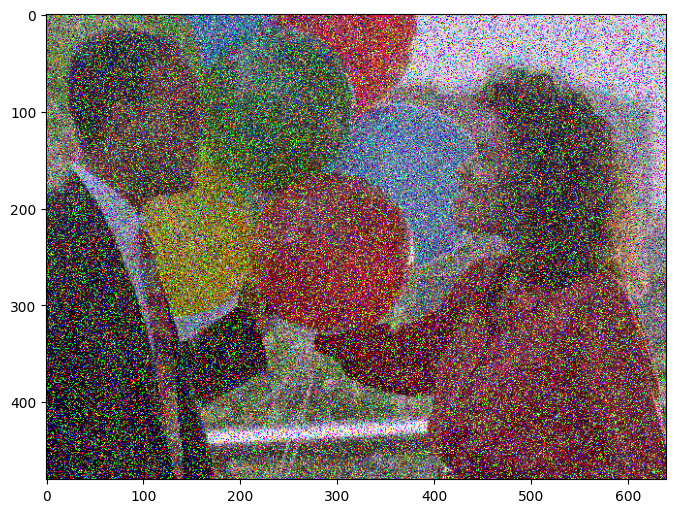

In [795]:
noisy_img2  = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/balloons_noisy.png')
noisy_img2 = cv2.cvtColor(noisy_img2,cv2.COLOR_BGR2RGB)
disp_img(noisy_img2)

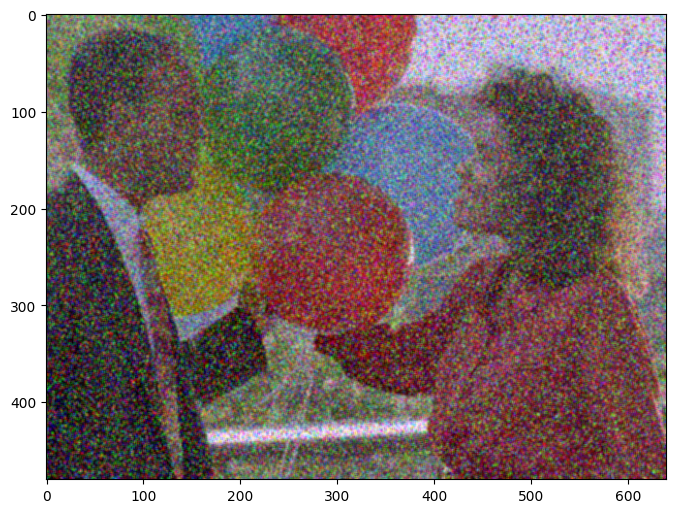

In [796]:
blur = cv2.blur(noisy_img2,ksize = (3,3))
disp_img(blur)

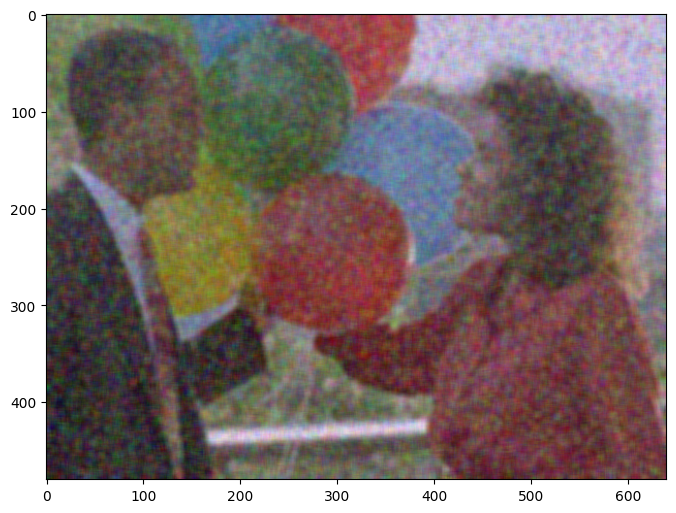

In [797]:
blur = cv2.blur(noisy_img2,ksize = (7,7))
disp_img(blur)

### cv2.GaussianBlur():

In [798]:
img2 = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img2,text = 'Bricks',org = (10,125),fontFace = font,fontScale = 2,color = (255,0,0),thickness = 1)
print('reset')

reset


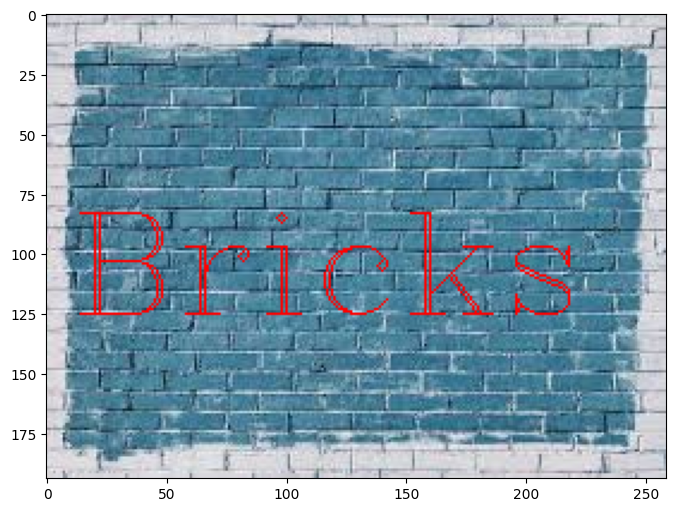

In [799]:
disp_img(img2)

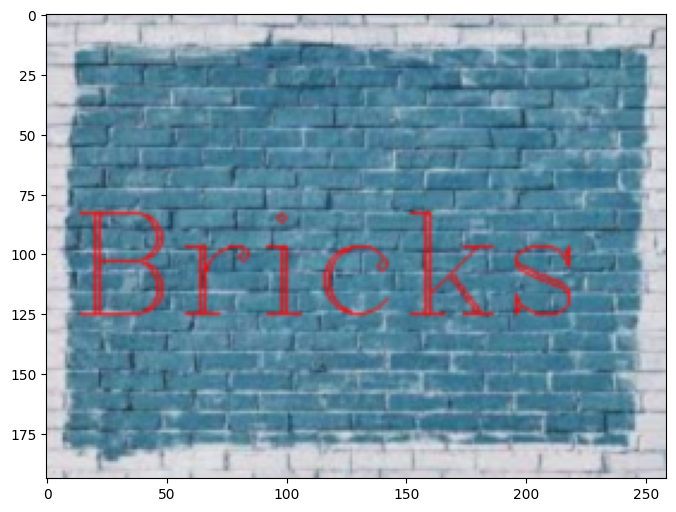

In [800]:
blur_img  = cv2.GaussianBlur(img2,(3,3),0.64)
disp_img(blur_img)

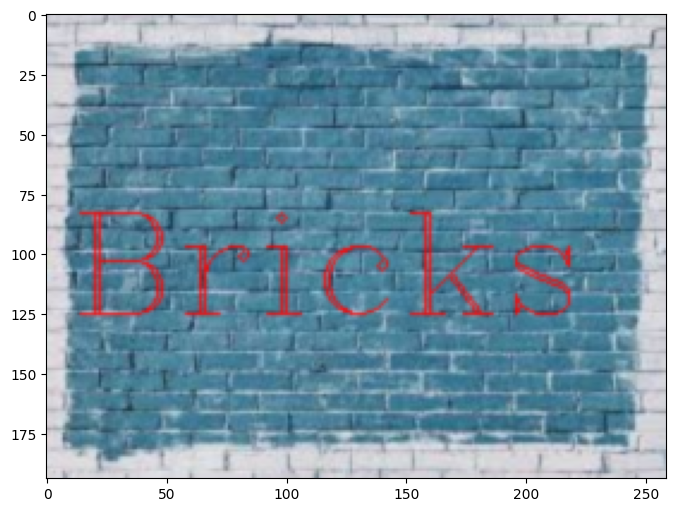

In [801]:
blur_img  = cv2.GaussianBlur(img2,(11,11),0.64)
disp_img(blur_img)

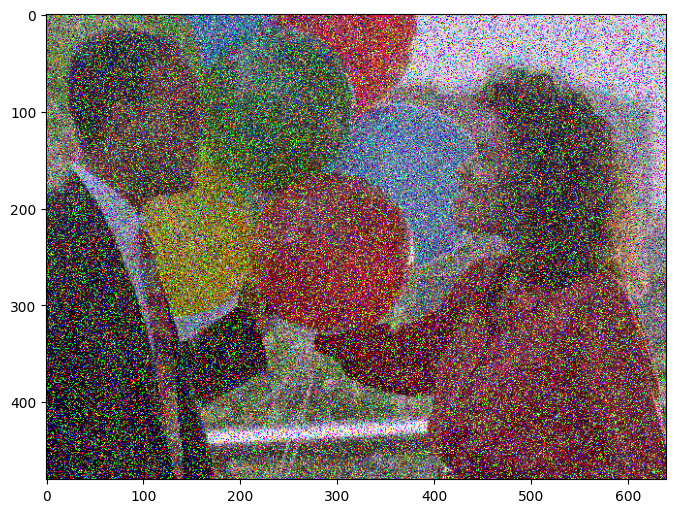

In [802]:
noisy_img1  = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/balloons_noisy.png')
noisy_img1 = cv2.cvtColor(noisy_img1,cv2.COLOR_BGR2RGB)
disp_img(noisy_img1)

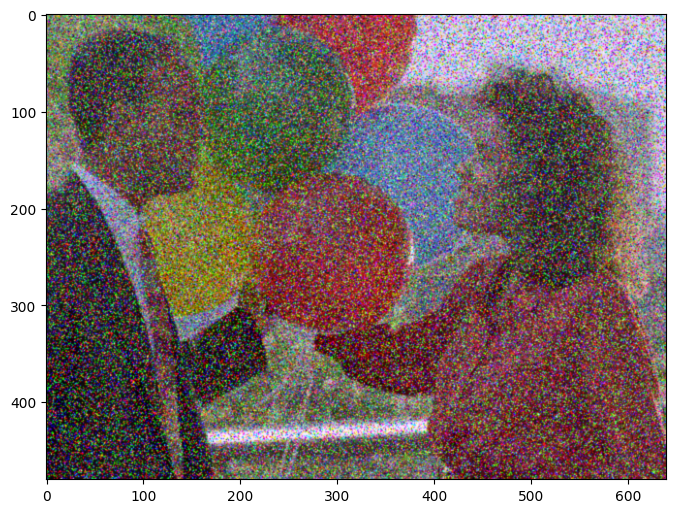

In [803]:
blur_img  = cv2.GaussianBlur(noisy_img1,(3,3),0.64)
disp_img(blur_img)

### Median Blur
필터 아래에 있는 모든 픽셀의 평균을 취한 다음 중앙 픽셀을 이 값으로 바꿈. 

In [804]:
img2 = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img2,text = 'Bricks',org = (10,125),fontFace = font,fontScale = 2,color = (255,0,0),thickness = 1)
print('reset')

reset


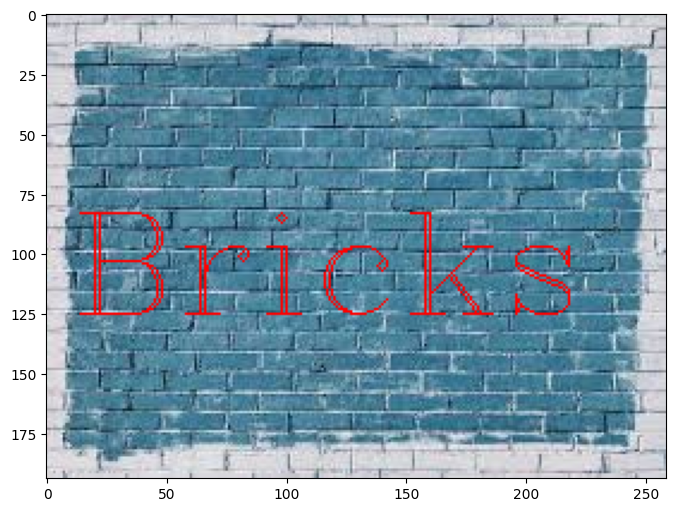

In [805]:
disp_img(img2)

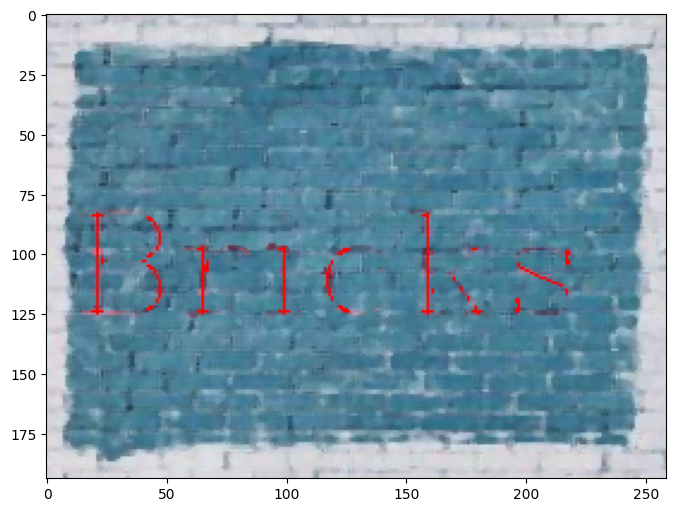

In [806]:
median_blur = cv2.medianBlur(img2,3)
disp_img(median_blur)

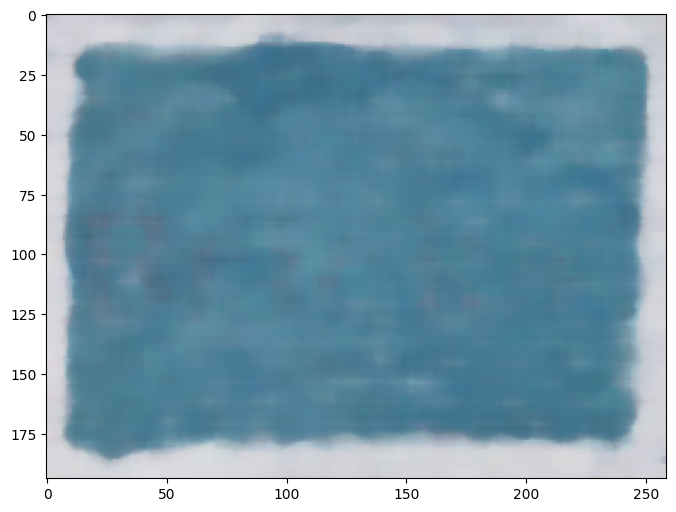

In [807]:
median_blur = cv2.medianBlur(img2,11)
disp_img(median_blur)

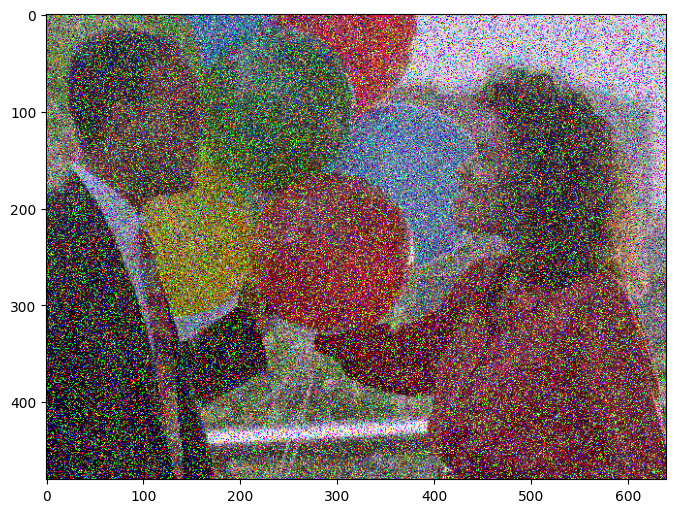

In [808]:
noisy_img  = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/balloons_noisy.png')
noisy_img = cv2.cvtColor(noisy_img,cv2.COLOR_BGR2RGB)
disp_img(noisy_img)

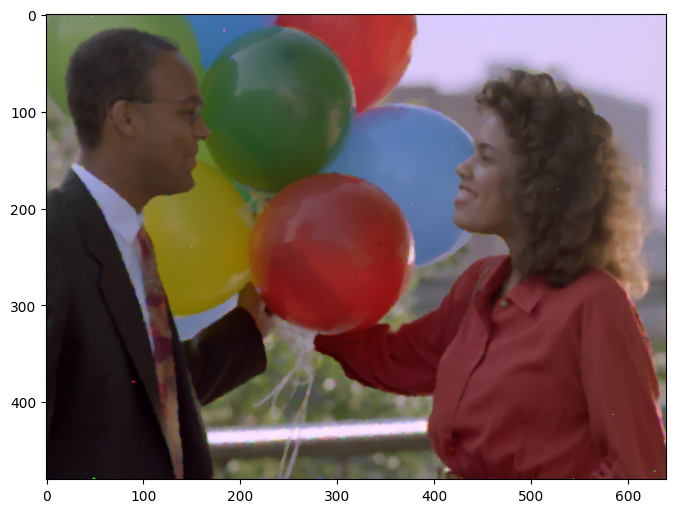

In [809]:
median = cv2.medianBlur(noisy_img,5)
disp_img(median)

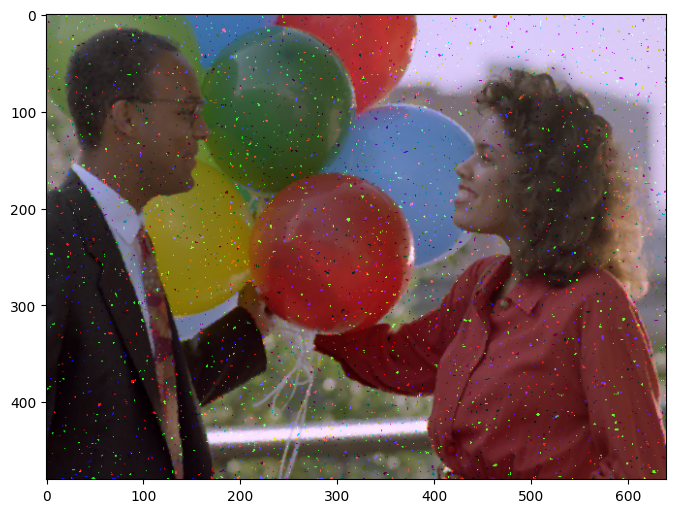

In [810]:
median = cv2.medianBlur(noisy_img,3)
disp_img(median)

### Color Histograms:
컬러 히스토그램에서는 R, G, B 컬러 채널의 픽셀값 분포를 시각화한다. 이를 통해 각 컬러 채널별로 어떤 픽셀값이 더 많은지 알 수 있음.

In [811]:
dark =cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/dark_image.jpg')
dark_img = cv2.cvtColor(dark,cv2.COLOR_BGR2RGB)

rainbo =cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/rainbo.jpg')
rainbo_img = cv2.cvtColor(rainbo,cv2.COLOR_BGR2RGB)

brick =cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/blue_brick.jpg')
brick_img = cv2.cvtColor(brick,cv2.COLOR_BGR2RGB)

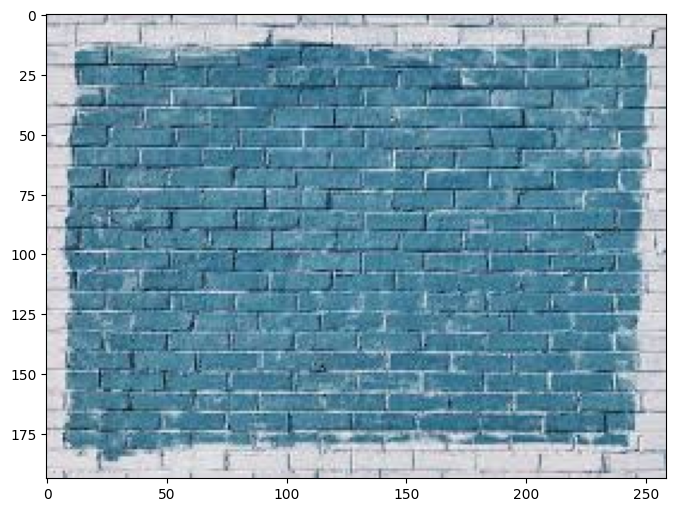

In [812]:
disp_img(brick_img)

In [813]:
rainbo_hist = cv2.calcHist([rainbo],channels = [0],mask = None,histSize= [256],ranges = [0,256])

In [814]:
rainbo_hist.shape

(256, 1)

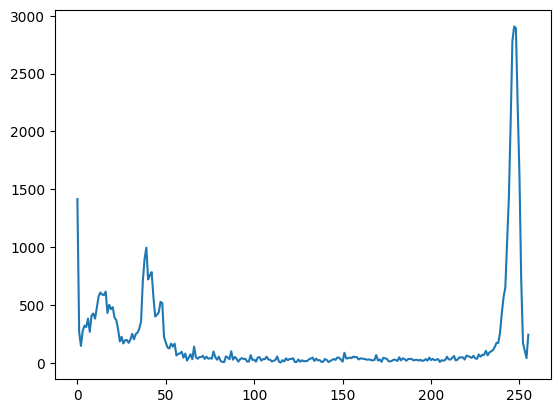

In [815]:
plt.plot(rainbo_hist)

### color 채널에 대한 histogram 만드는 법

Text(0.5, 1.0, 'hist for brick')

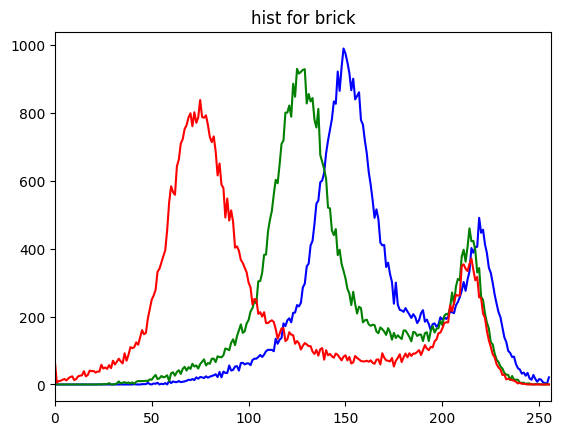

In [816]:
color = ('b','g','r')

for i,col in enumerate(color):
    hist = cv2.calcHist([brick],[i],None,[256],[0,256])
    plt.plot(hist,color = col)
    plt.xlim([0,256])
    #plt.ylim()
plt.title('hist for brick')

Text(0.5, 1.0, 'hist for rainbo')

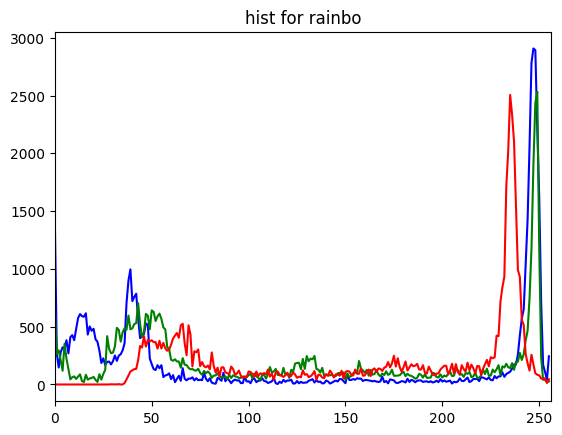

In [817]:
color = ('b','g','r')

for i,col in enumerate(color):
    hist = cv2.calcHist([rainbo],[i],None,[256],[0,256])
    plt.plot(hist,color = col)
    plt.xlim([0,256])
    #plt.ylim()
plt.title('hist for rainbo')

### image에서 마스크된 분포에 대한 histogram 만드는 법

In [818]:
rainbo =cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/rainbo.jpg')
rainbo_img = cv2.cvtColor(rainbo,cv2.COLOR_BGR2RGB)

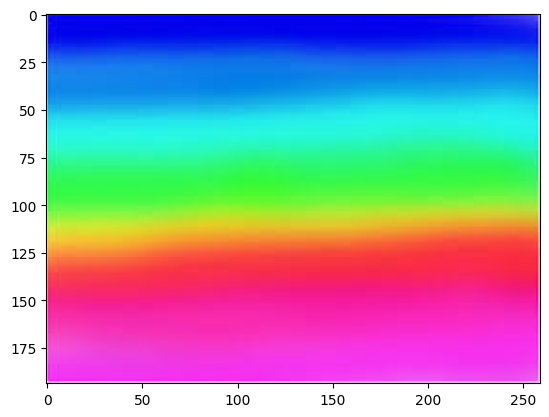

In [819]:
plt.imshow(rainbo)

In [820]:
rainbo_img.shape

(194, 259, 3)

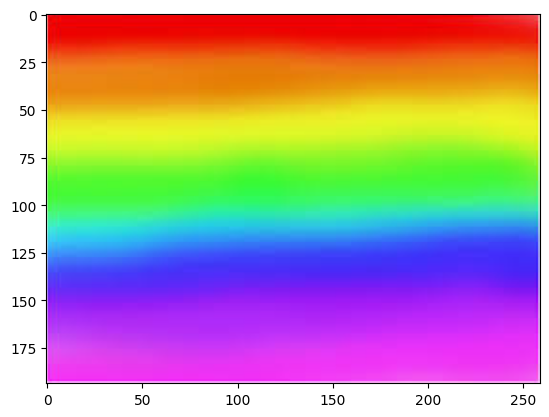

In [821]:
plt.imshow(rainbo_img)

In [822]:
mask = np.zeros(rainbo_img.shape[:2],np.uint8)

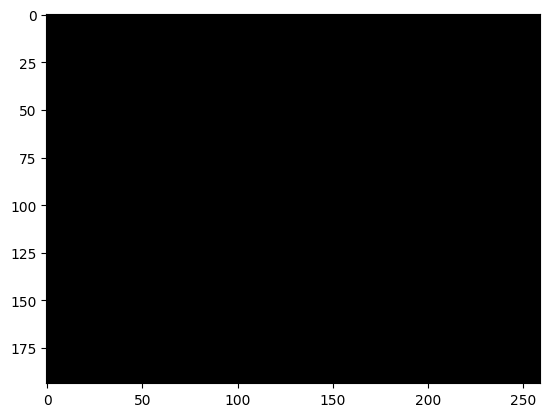

In [823]:
plt.imshow(mask,cmap = 'gray')

In [824]:
mask[75:100,50:100] = 255

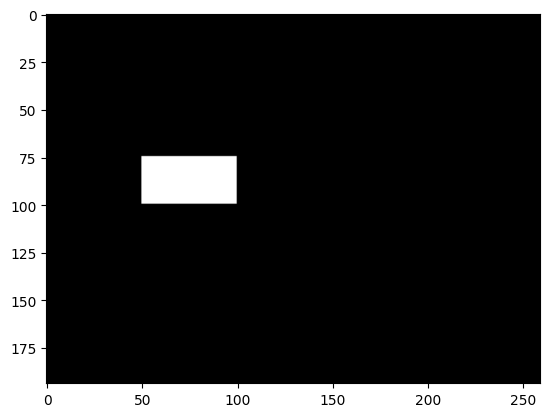

In [825]:
plt.imshow(mask,cmap = 'gray')

In [826]:
masked_img = cv2.bitwise_and(rainbo,rainbo,mask = mask)
show_masked_img = cv2.bitwise_and(rainbo_img,rainbo_img,mask = mask)

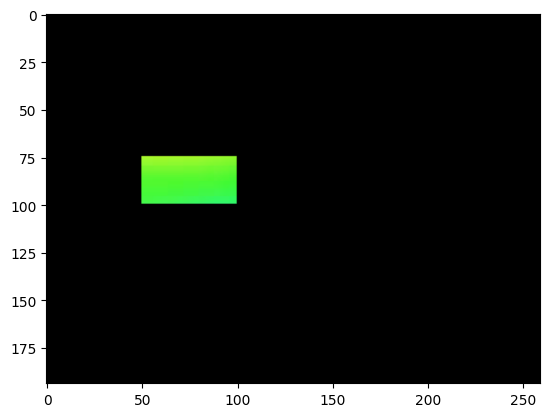

In [827]:
plt.imshow(show_masked_img)

In [828]:
hist_mask = cv2.calcHist([rainbo],[2],mask,[256],[0,256])

In [829]:
hist_not_mask = cv2.calcHist([rainbo],[2],None,[256],[0,256])

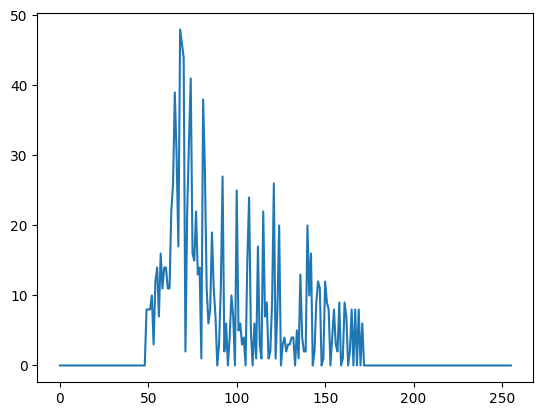

In [830]:
plt.plot(hist_mask)

In [831]:
hist_mask_green = cv2.calcHist([rainbo],[1],mask,[256],[0,256])

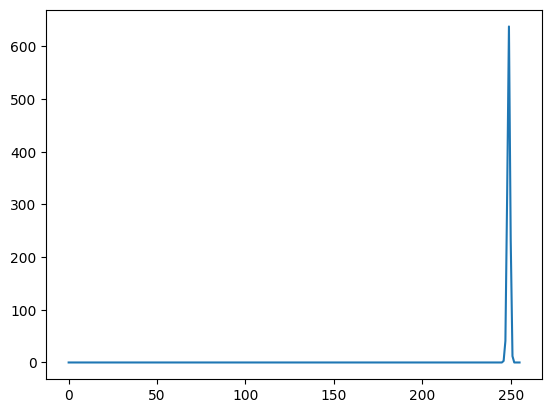

In [832]:
plt.plot(hist_mask_green)

### histogram equalization 수행 방법


### histogram equalization 수행 방법
: 영상의 히스토그램을 기준으로 대비를 조정하는 방법

이 이미지에서 픽셀 값은 0-255 사이이지만 정확히 0 또는 255인 픽셀 값을 찾을 수 없음. 히스토그램 균등화를 적용하면 색상 깊이가 줄어든다. 현재 최소 픽셀 값은 52이고 최고 픽셀 값은 255임. 히스토그램 균등화를 적용하면 최소 픽셀 값이 0으로 변환되고 최대값이 255로 변환된다.

In [833]:
gorilla = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/gorilla.jpg')
gorilla = cv2.cvtColor(gorilla,cv2.COLOR_BGR2GRAY)

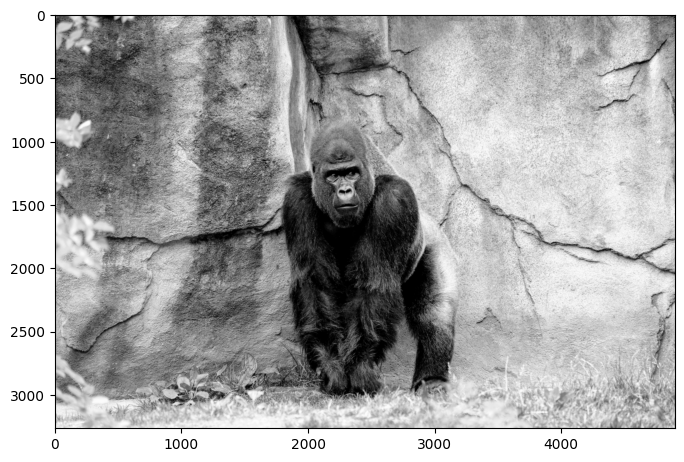

In [834]:
disp_img(gorilla,cmap = 'gray')

In [835]:
eq_gorilla = cv2.equalizeHist(gorilla)

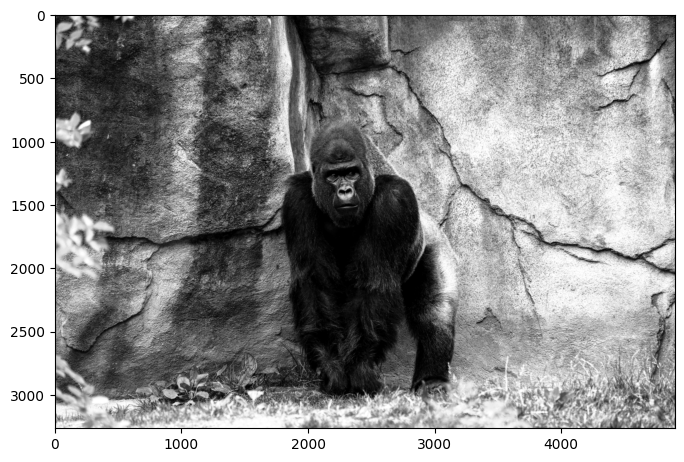

In [836]:
disp_img(eq_gorilla,cmap = 'gray')

### Line Detection
cv2.HoughLinesP()를 사용하여 캐니 에지 디텍터를 사용하여 에지를 감지하는 마스크를 만든 다음 해당 Hough line 예측 함수에 해당 작업을 적용

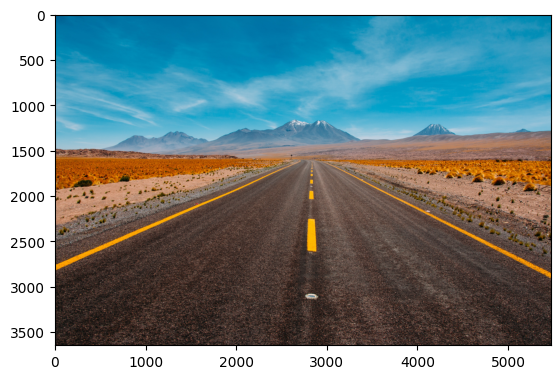

In [837]:
road = cv2.imread('../input/cv-object-detecton-dataset/CV Object Detecton Dataset/yello_road.jpg')
road = cv2.cvtColor(road,cv2.COLOR_BGR2RGB)
plt.imshow(road)

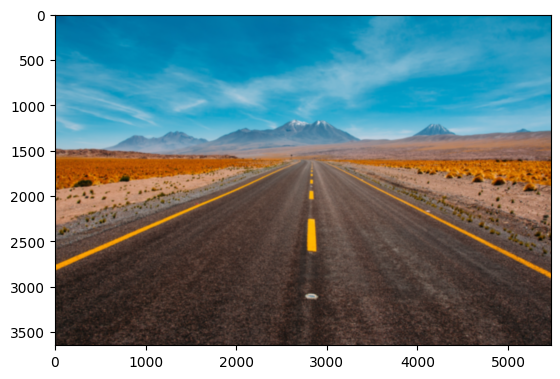

In [838]:
blurry = cv2.GaussianBlur(road,(35,35),0)
plt.imshow(blurry)
blur_img = blurry.copy()

In [848]:
blur_img4 = blurry.copy()

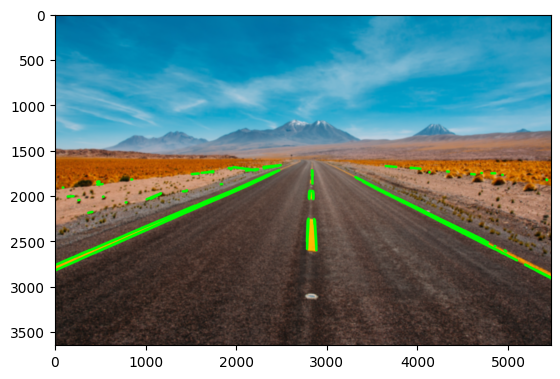

In [846]:
hsv = cv2.cvtColor(blur_img4,cv2.COLOR_RGB2HSV)
low_yellow = np.array([18,94,140])
up_yellow = np.array([48,230,230])
mask = cv2.inRange(hsv,low_yellow,up_yellow)
edge = cv2.Canny(mask,75,150)

line = cv2.HoughLinesP(edge,1,np.pi/180,50,maxLineGap = 50)

for i in line:
    x1,y1,x2,y2 = i[0]
    cv2.line(blur_img4,(x1,y1),(x2,y2),(0,255,0),25)
    
plt.imshow(blur_img4)

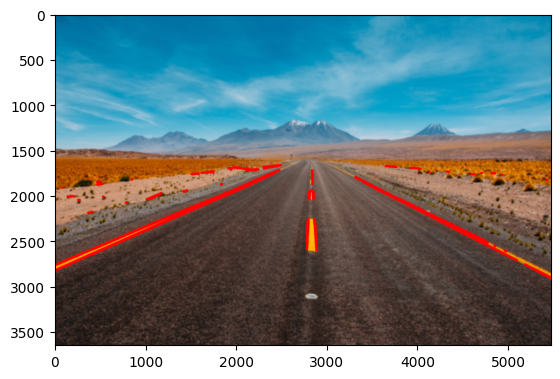

In [849]:
hsv = cv2.cvtColor(blur_img4,cv2.COLOR_RGB2HSV)
low_yellow = np.array([18,94,140])
up_yellow = np.array([48,230,230])
mask = cv2.inRange(hsv,low_yellow,up_yellow)
edge = cv2.Canny(mask,75,150)

line = cv2.HoughLinesP(edge,1,np.pi/180,50,maxLineGap = 50)

for i in line:
    x1,y1,x2,y2 = i[0]
    cv2.line(blur_img4,(x1,y1),(x2,y2),(255,0,0),25)
    
plt.imshow(blur_img4)